## Create the preictions and load the RCWA file for predictions

In [1]:
from scipy.io import savemat
import scipy.io     # used to load .mat data

import pandas as pd
import numpy as np
import pickle as pkl
from sklearn.preprocessing import StandardScaler

import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt

import seaborn as sns

from models import TandemNet, MLP ,cVAE, cGAN, INN, cVAE_new, cVAE_GSNN
from models import MLP, TandemNet, cVAE, cGAN, INN, cVAE_new, cVAE_GSNN, cVAE_Full, cVAE_hybrid, cVAE_tandem, cVAE_GSNN1
from utils import evaluate_tandem_minmax_accuracy, evaluate_forward_minmax_dataset, evaluate_forward_minmax, evaluate_vae_GSNN_minmax_inverse, evaluate_gan_minmax_inverse
from configs import get_configs
from plotting_utils import compare_cie_dist, compare_param_dist, plot_cie, plot_cie_raw_pred, plt_abs_err, plt_hist_struc, plot_struc_raw_pred
from datasets import get_dataloaders, SiliconColor

from sklearn.metrics import r2_score

DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
train_loader, val_loader, test_loader = get_dataloaders('forward_model')




## Check forward model

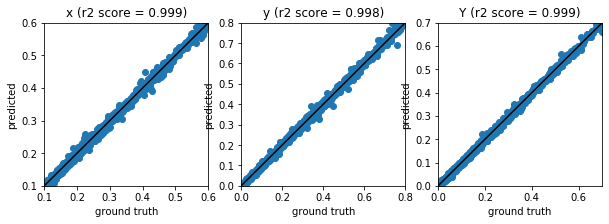

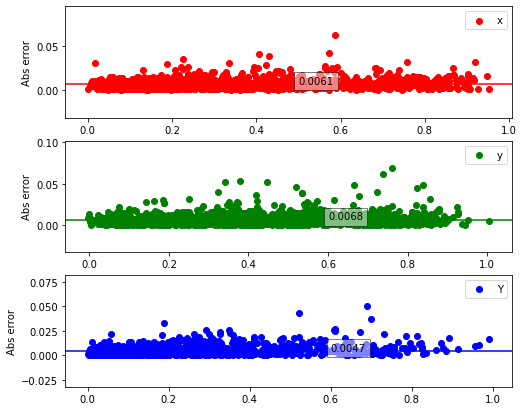

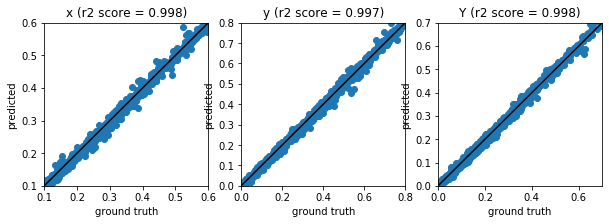

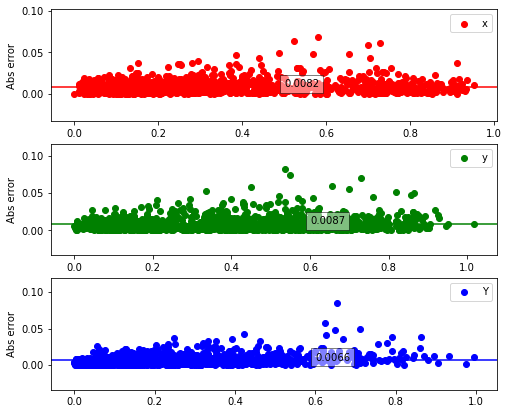

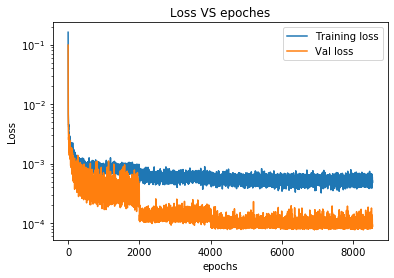

In [168]:
# used for training 
forward_model = MLP(4, 3).to(DEVICE)
forward_model.load_state_dict(torch.load('./models/forward_model_trained_training.pth')['model_state_dict'])
forward_path = './models/forward/forward__lr_0.001_STEP_True_trained.pth'
forward_model.load_state_dict(torch.load(forward_path)['model_state_dict'])

cie_pred, cie_raw = evaluate_forward_minmax_dataset(forward_model, test_loader.dataset)

plot_cie_raw_pred(cie_raw, cie_pred)
# Plot Absolute Error: target - forward 
plt_abs_err(cie_raw, cie_pred)

# used for evaluation 
forward_model = MLP(4, 3).to(DEVICE)
forward_model.load_state_dict(torch.load('./models/forward_model_trained_evaluate_1.pth')['model_state_dict'])
cie_pred, cie_raw = evaluate_forward_minmax_dataset(forward_model, test_loader.dataset)
plot_cie_raw_pred(cie_raw, cie_pred)

# Plot Absolute Error target - forward 
plt_abs_err(cie_raw, cie_pred)

# plot the training and val loss VS epoches.
epochs = torch.load(forward_path)['epoch']
gan_loss_all = torch.load(forward_path)['loss_all']
plt.figure()
plt.plot(range(epochs),gan_loss_all[0,:epochs],label='Training loss')  
plt.plot(range(epochs),gan_loss_all[1,:epochs],label='Val loss')                     
plt.xlabel('epochs')
plt.ylabel('Loss')
plt.yscale('log')
plt.title('Loss VS epoches')
plt.legend()

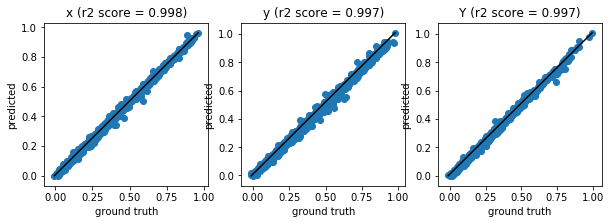

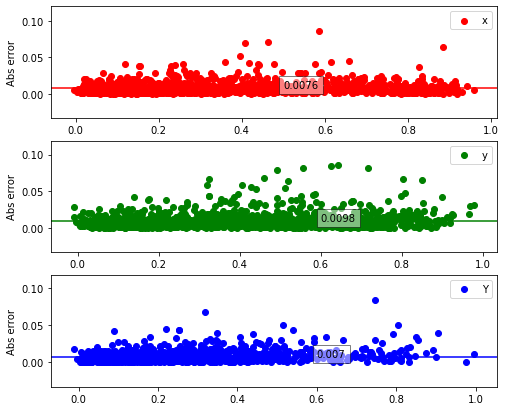

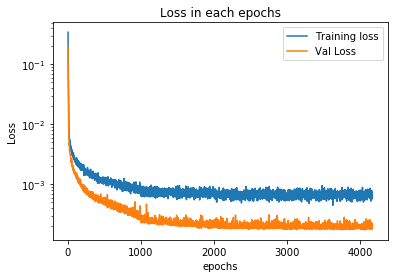

In [43]:
forward_model = MLP(4, 3).to(DEVICE)
forward_model.load_state_dict(torch.load('./models/forward_model_trained.pth')['model_state_dict'])

cie_pred, cie_raw = evaluate_forward_minmax_dataset(forward_model, test_loader.dataset)
plot_cie_raw_pred(cie_raw, cie_pred)
# Plot Absolute Error: target - forward 
plt_abs_err(cie_raw, cie_pred)

# plot the training and validation loss VS training epoches
file_path = './models/forward_model_trained.pth'
epochs = torch.load('./models/forward_model_trained.pth')['epoch']
forward_loss_all = torch.load(file_path)['loss_all']
plt.figure()
plt.plot(range(epochs),forward_loss_all[0,:epochs],label='Training loss')  
plt.plot(range(epochs),forward_loss_all[1,:epochs],label='Val Loss')                 
plt.xlabel('epochs')
plt.ylabel('Loss')
plt.yscale('log')
plt.title('Loss in each epochs')
plt.legend()

# Tandem 


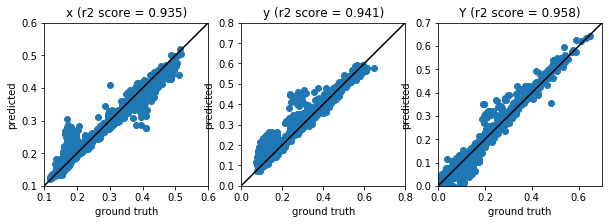

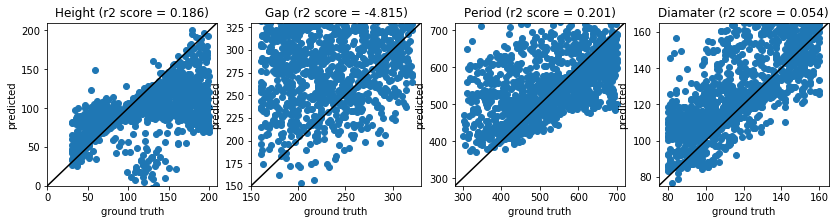

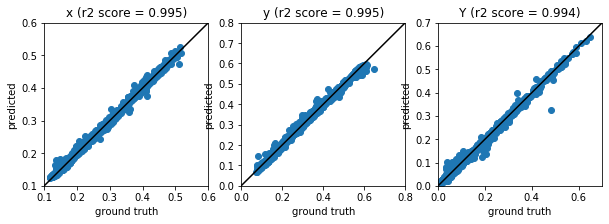

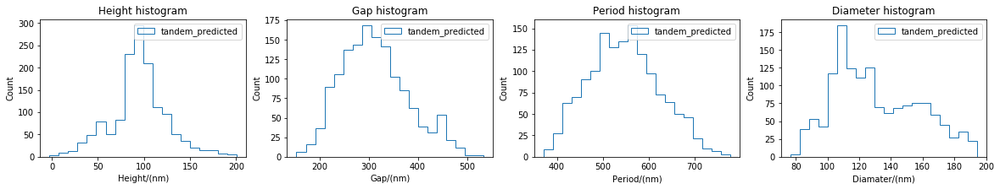

In [143]:
forward_model = MLP(4, 3).to(DEVICE)
inverse_model = MLP(3, 4).to(DEVICE)

tandem_model = TandemNet(forward_model, inverse_model)
tandem_model.load_state_dict(torch.load('./models/tandem_net_trained_1.pth')['model_state_dict'])

# evaluate on a different forward model
forward_model.load_state_dict(torch.load('./models/forward_model_trained_evaluate_3.pth')['model_state_dict'])
cie_raw, param_raw, cie_pred, param_pred = evaluate_tandem_minmax_accuracy(tandem_model, forward_model, test_loader.dataset, show=0)
plot_cie_raw_pred(cie_raw, cie_pred)
plot_struc_raw_pred(param_raw, param_pred)

# evaluate on the same forward model
forward_model.load_state_dict(torch.load('./models/forward_model_trained_training.pth')['model_state_dict'])
cie_raw, param_raw, cie_pred, param_pred = evaluate_tandem_minmax_accuracy(tandem_model, tandem_model.forward_model, test_loader.dataset, show=0)

plot_cie_raw_pred(cie_raw, cie_pred)
plt_hist_struc(param_pred, 'tandem_predicted')

In [8]:
# define some necessary functions for the predictions
def struc_check(structure):
    if np.sum(abs(structure)-structure)>0:  # if get negative parameters, then wrong structure
        return 0
    else:
        struc = np.reshape(structure, (-1, 4));
        N = np.shape(struc)[0]
        #print(struc)
        for i in range(N):
            if (struc[i,1]+struc[i,3]>=struc[i,2]):  # if gap+diameter >= period, then wrong structure
                return 0;
            
        return 1;

def struc_remove_1(param_pred):
    M = np.shape(param_pred)[0]
    B = []
    print(M)
    for i in range(M):
        if struc_check(param_pred[i,:])==0:
            B.append(i)
            print(i)
    
    return B

def struc_remove_2(param_pred):
    # remove the structure that is not inside the parameter range space. 
    M = np.shape(param_pred)[0]
    B = []
    for i in range(M):
        if (param_pred[i,3]>=160)|(param_pred[i,3]<=80)|(param_pred[i,0]>=200)|(param_pred[i,0]<=30)|(param_pred[i,1]>=320)|(param_pred[i,1]<=160)|(param_pred[i,2]>=700)|(param_pred[i,2]<=30):
            B.append(i)
            #print(i)
    
    return B




In [5]:
# Save the predicted structure data 

mdic = {"param_pred_all": param_pred,"cie_pre_all":cie_pred,"param_test_all": param_raw,"CIE_x_all": cie_raw}
savemat("./data_predicted/param_tandem_pred_all.mat",mdic)

B = struc_remove_1(param_pred)

cie_pred = np.delete(cie_pred, B, 0)
cie_raw = np.delete(cie_raw, B, 0)
param_pred = np.delete(param_pred, B, 0)
param_raw = np.delete(param_raw, B, 0)

mdic = {"param_pred": param_pred,"param_test": param_raw,"cie_pred": cie_pred, "CIE_x": cie_raw, "deleted_row":B}
savemat("./data_predicted/param_tandem_pred.mat",mdic)
np.shape(param_pred)

1411
145
172
337
614
637
781
956
1108


(1403, 4)

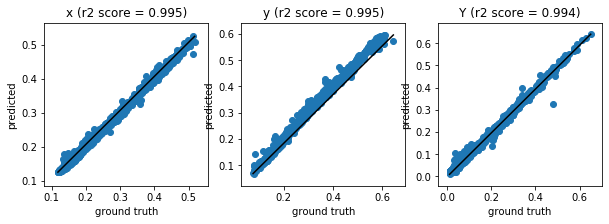

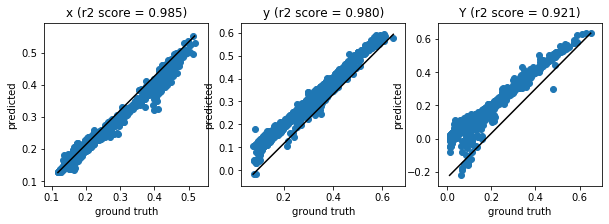

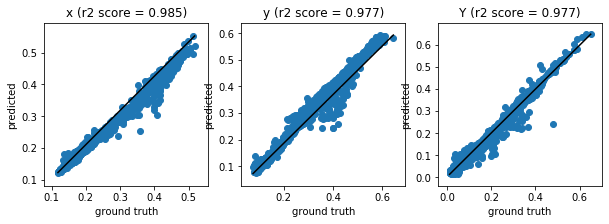

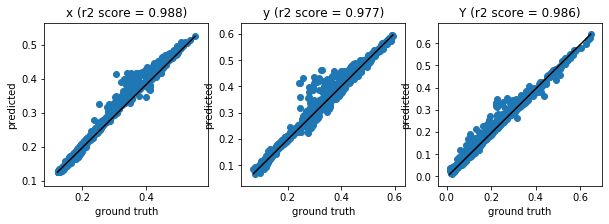

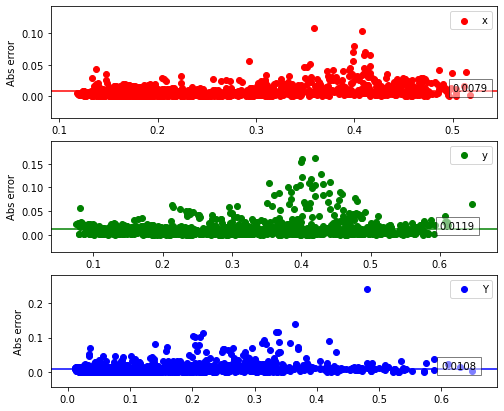

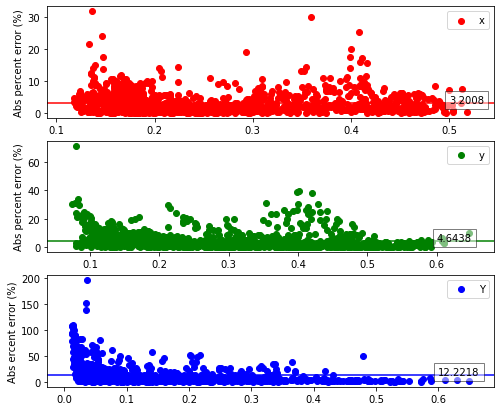

In [88]:

filepath ="./data_predicted/xyY/xyY_param_tandem_pred.mat"
filepath3 = "./data_predicted/param_tandem_pred.mat"

temp = scipy.io.loadmat(filepath3)
delete_row = np.array(list(temp.items())[7][1])

temp = scipy.io.loadmat(filepath)

#print(temp.items())
CIE_x = np.array(list(temp.items())[3][1])  # target
cie_pred = np.array(list(temp.items())[4][1])[:,0:3] # predicted by forward model
param_pred = np.array(list(temp.items())[5][1])[:, 0:4]
param_test = np.array(list(temp.items())[6][1])
xyY_pred = np.array(list(temp.items())[7][1])  # predicted by RCWA

# Evaluation 1.1: comparing the CIE target VS forward
plot_cie_raw_pred(CIE_x, cie_pred)

# Evaluation 1.2: comparing the CIE target VS evaluating forward
forward_model = MLP(4, 3).to(DEVICE)
forward_model.load_state_dict(torch.load('./models/forward_model_trained_evaluate_1.pth')['model_state_dict'])
cie_pred_1 = evaluate_forward_minmax(forward_model,test_loader.dataset,param_pred)
plot_cie_raw_pred(CIE_x, cie_pred_1)

# Evaluation 2：comparing the CIE target VS RCWA
plot_cie_raw_pred(CIE_x, xyY_pred)

# Evaluation 3: comparing the CIE forward VS RCWA
plot_cie_raw_pred(xyY_pred, cie_pred)

# Evaluation 4: absoulute mean
plt_abs_err(CIE_x, xyY_pred)

# Evaluation 5: absoulute percent mean
plt_abs_percent_err(CIE_x, xyY_pred)

In [93]:
print(np.shape(cie_pred))
print(np.shape(B))

(1403, 3)
(740,)


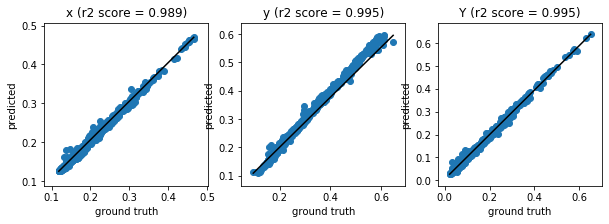

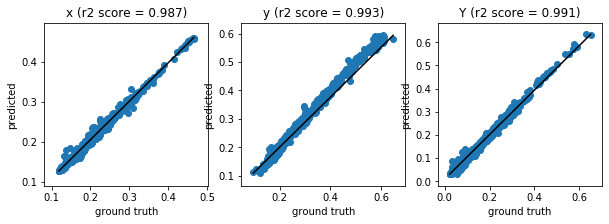

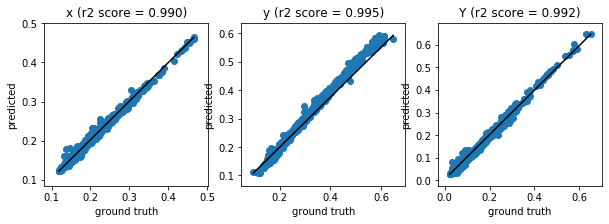

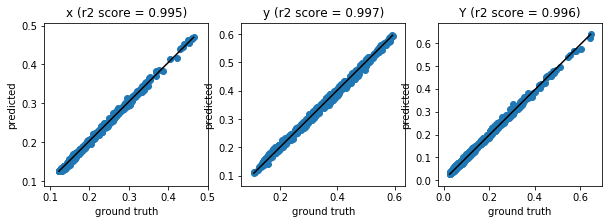

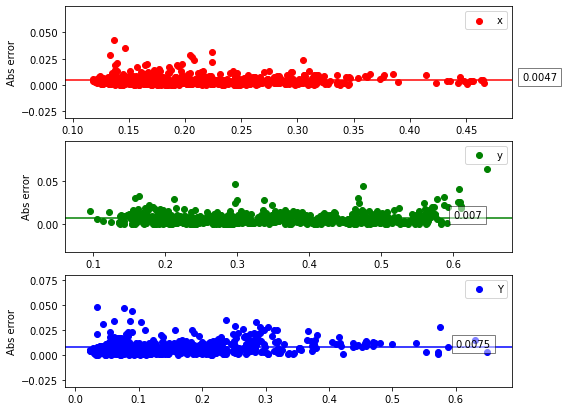

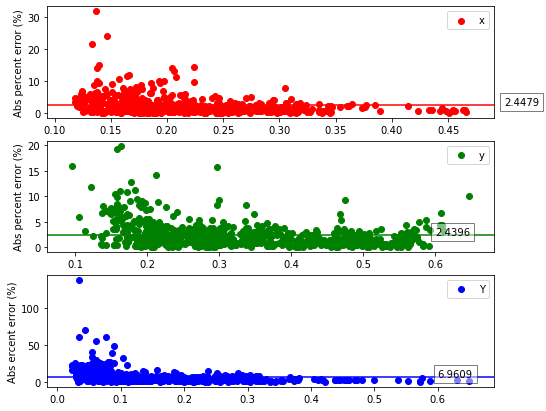

In [89]:
# delete the structure that are outside the range of training data 

B = struc_remove_2(param_pred)

CIE_x1 = np.delete(CIE_x, B, axis=0)
cie_pred1 = np.delete(cie_pred, B, axis=0)
cie_pred_11 = np.delete(cie_pred_1, B, axis=0)
param_pre1 = np.delete(param_pred, B, axis=0)
param_test1 = np.delete(param_test, B, axis=0)
xyY_pred1 = np.delete(xyY_pred, B, axis=0)

# evaluate 1.1: compare the target VS training forward model
plot_cie_raw_pred(CIE_x1, cie_pred1)

# evaluate 1.1: compare the target VS evaluating forward model
plot_cie_raw_pred(CIE_x1, cie_pred_11)

# Evaluation 2：comparing the CIE target VS RCWA
plot_cie_raw_pred(CIE_x1, xyY_pred1)

# Evaluation 3: comparing the CIE forward VS RCWA
plot_cie_raw_pred(xyY_pred1, cie_pred1)

# Evaluation 4: absoulute mean
plt_abs_err(CIE_x1, xyY_pred1)

# Evaluation 5: absoulute percent mean
plt_abs_percent_err(CIE_x1, xyY_pred1)

# VAE_hybrid

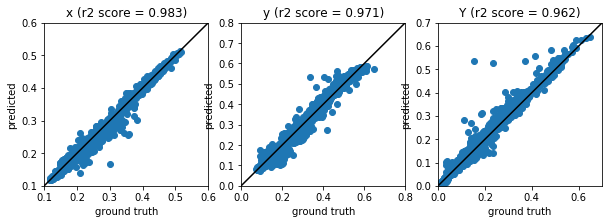

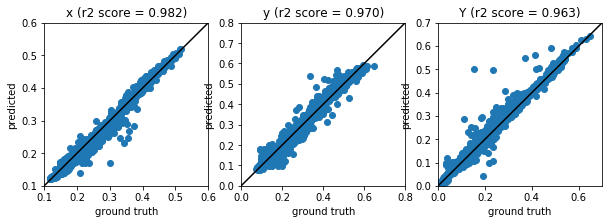

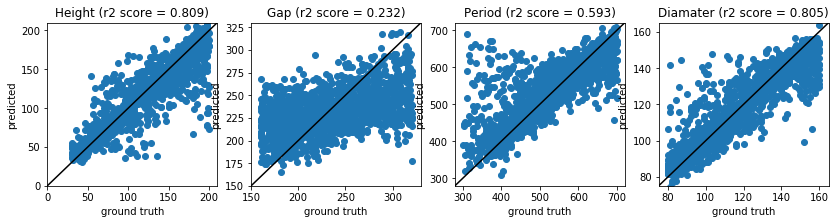

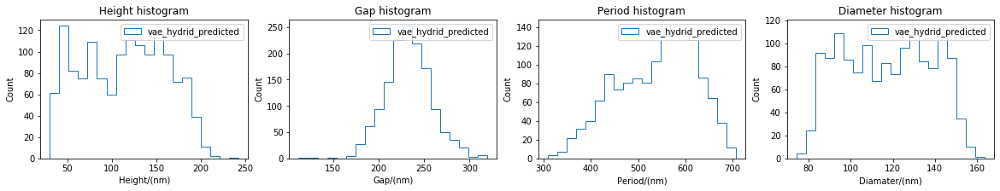

In [221]:
# Train the vae based on forward model, where vae model is GSNN model :

forward_model = MLP(4, 3).to(DEVICE)

configs = get_configs('vae_hybrid')
vae_model = cVAE_GSNN1(configs['input_dim'], configs['latent_dim']).to(DEVICE)
model = cVAE_hybrid(forward_model, vae_model)
vae_path = './models/cvae/cvae_forward_True_latent_4_lr_0.001_STEP_False_trained.pth'
#vae_path = './models/vae_hybrid_GSNN1_1_trained.pth'
model.load_state_dict(torch.load(vae_path)['model_state_dict'])

# different forward model for evaluation 
forward_model.load_state_dict(torch.load('./models/forward_model_trained_evaluate_1.pth')['model_state_dict'])
cie_raw, param_raw, cie_pred, param_pred = evaluate_vae_GSNN_minmax_inverse(model.vae_model, forward_model, test_loader.dataset, show=0)
plot_cie_raw_pred(cie_raw, cie_pred)

# same forward model for evaluation 
forward_model.load_state_dict(torch.load('./models/forward_model_trained_training.pth')['model_state_dict'])
cie_raw, param_raw, cie_pred, param_pred = evaluate_vae_GSNN_minmax_inverse(model.vae_model, model.forward_model, test_loader.dataset, show=0)
plot_cie_raw_pred(cie_raw, cie_pred)

plot_struc_raw_pred(param_raw, param_pred)
plt_hist_struc(param_pred, 'vae_hydrid_predicted')

In [57]:
# Save the predicted structure data 

mdic = {"param_pred_all": param_pred,"cie_pre_all":cie_pred,"param_test_all": param_raw,"CIE_x_all": cie_raw}
savemat("./data_predicted/param_vae_hybrid_GSNN1_1_pred_all.mat",mdic)

B = struc_remove_1(param_pred)

cie_pred = np.delete(cie_pred, B, 0)
cie_raw = np.delete(cie_raw, B, 0)
param_pred = np.delete(param_pred, B, 0)
param_raw = np.delete(param_raw, B, 0)

mdic = {"param_pred": param_pred,"param_test": param_raw,"cie_pred": cie_pred, "CIE_x": cie_raw, "deleted_row":B}
savemat("./data_predicted/param_vae_hybrid_GSNN1_1_pred.mat",mdic)
np.shape(param_pred)

1411
771


(1410, 4)

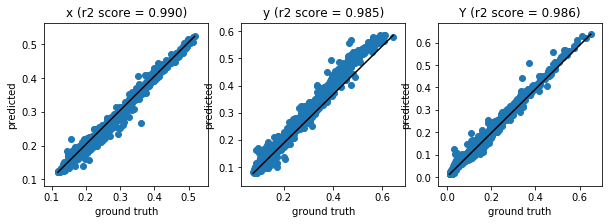

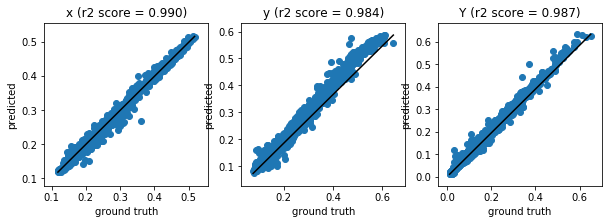

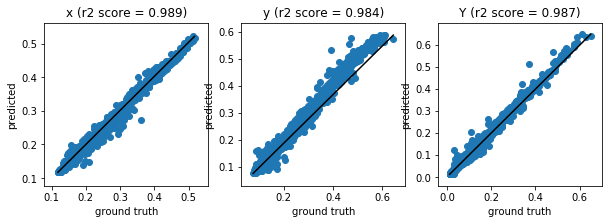

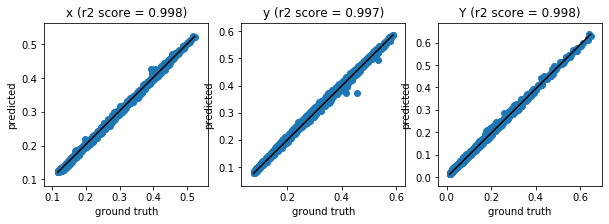

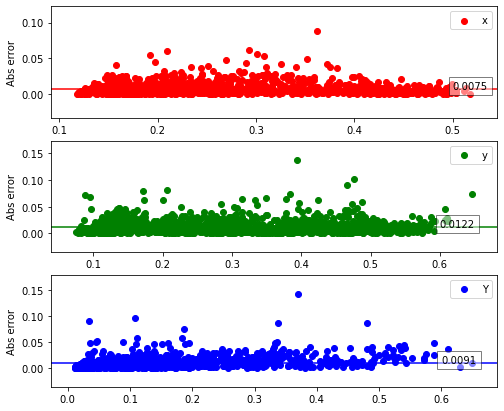

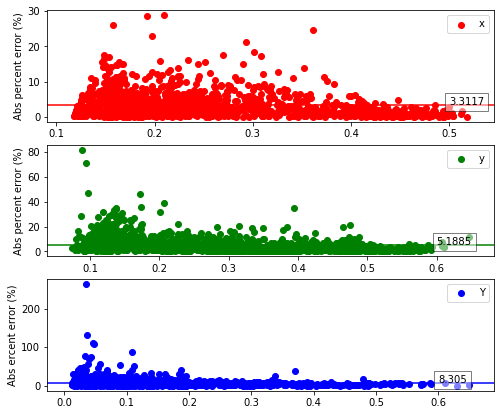

In [94]:

#filepath ="./data_predicted/xyY/xyY_param_vae_hybrid_pred.mat"
#filepath3 = "./data_predicted/param_vae_hybrid_pred.mat"

filepath ="./data_predicted/xyY/xyY_param_vae_hybrid_GSNN1_1_pred.mat"
filepath3 = "./data_predicted/param_vae_hybrid_GSNN1_1_pred.mat"

temp = scipy.io.loadmat(filepath3)
delete_row = np.array(list(temp.items())[7][1])

temp = scipy.io.loadmat(filepath)

#print(temp.items())
CIE_x = np.array(list(temp.items())[3][1])  # target
cie_pred = np.array(list(temp.items())[4][1])[:,0:3] # predicted by forward model
param_pred = np.array(list(temp.items())[5][1])[:, 0:4]
param_test = np.array(list(temp.items())[6][1])
xyY_pred = np.array(list(temp.items())[7][1])  # predicted by RCWA

# Evaluation 1.1: comparing the CIE target VS forward
plot_cie_raw_pred(CIE_x, cie_pred)

# Evaluation 1.2: comparing the CIE target VS evaluating forward
forward_model = MLP(4, 3).to(DEVICE)
forward_model.load_state_dict(torch.load('./models/forward_model_trained_evaluate_1.pth')['model_state_dict'])
cie_pred_1 = evaluate_forward_minmax(forward_model,test_loader.dataset,param_pred)
plot_cie_raw_pred(CIE_x, cie_pred_1)

# Evaluation 2：comparing the CIE target VS RCWA
plot_cie_raw_pred(CIE_x, xyY_pred)

# Evaluation 3: comparing the CIE forward VS RCWA
plot_cie_raw_pred(xyY_pred, cie_pred)

# Evaluation 4: absoulute mean
plt_abs_err(CIE_x, xyY_pred)

plt_abs_percent_err(CIE_x, xyY_pred)

In [60]:
def plt_abs_percent_err(CIE_x, cie_pred):
    abs_err = abs(CIE_x - cie_pred)/CIE_x*100
    abs_mean = sum(abs_err)/len(abs_err)
    
    plt.figure(figsize = [8, 7])
    plt.subplot(3,1 ,1)
    plt.scatter(CIE_x[:,0],abs_err[:,0], color='r',label='x')
    plt.axhline(y=abs_mean[0],color='r', linestyle='-')
    plt.text(0.5,abs_mean[0] , str(round(abs_mean[0],4)), bbox=dict(facecolor='w', alpha=0.5))
    plt.ylabel('Abs percent error (%)')
    plt.legend()
    
    plt.subplot(3,1,2)
    plt.scatter(CIE_x[:,1],abs_err[:,1], color='g',label='y')
    plt.axhline(y=abs_mean[1], color='g',linestyle='-')
    plt.text(0.6,abs_mean[1] , str(round(abs_mean[1],4)), bbox=dict(facecolor='w', alpha=0.5))
    plt.ylabel('Abs percent error (%)')
    plt.legend()
    
    plt.subplot(3,1, 3)
    plt.scatter(CIE_x[:,2],abs_err[:,2], color='b',label='Y')
    plt.axhline(y=abs_mean[2], color='b',linestyle='-')
    plt.text(0.6,abs_mean[2] , str(round(abs_mean[2],4)), bbox=dict(facecolor='w', alpha=0.5))
    plt.ylabel('Abs ercent error (%)')
    plt.legend()


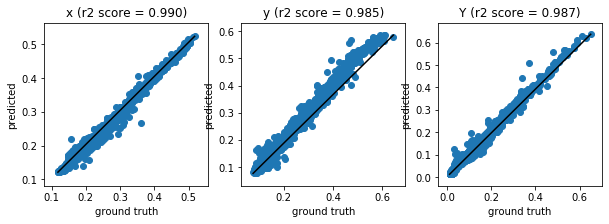

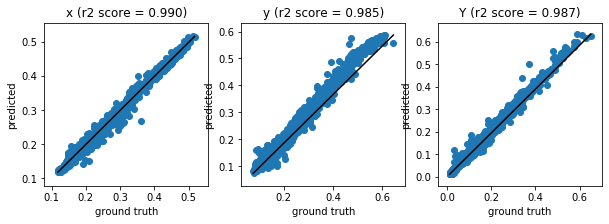

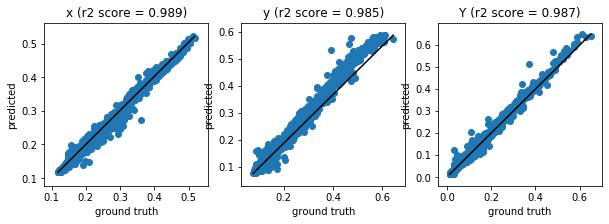

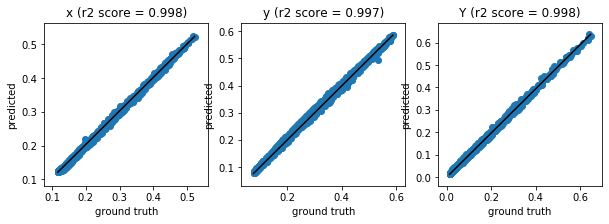

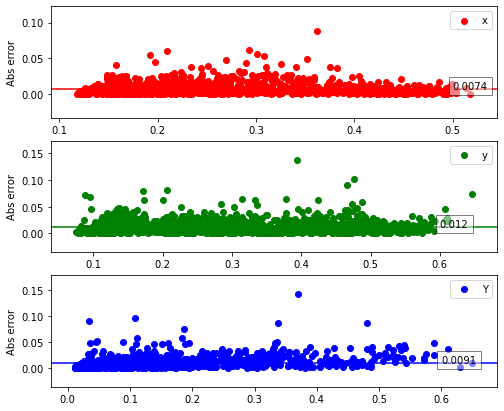

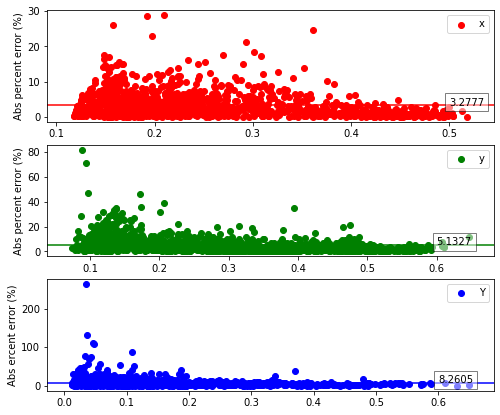

In [95]:
# delete the structure that are outside the range of training data 

B = struc_remove_2(param_pred)

CIE_x1 = np.delete(CIE_x, B, axis=0)
cie_pred1 = np.delete(cie_pred, B, axis=0)
cie_pred_11 = np.delete(cie_pred_1, B, axis=0)
param_pre1 = np.delete(param_pred, B, axis=0)
param_test1 = np.delete(param_test, B, axis=0)
xyY_pred1 = np.delete(xyY_pred, B, axis=0)

# evaluate 1.1: compare the target VS training forward model
plot_cie_raw_pred(CIE_x1, cie_pred1)

# evaluate 1.1: compare the target VS evaluating forward model
plot_cie_raw_pred(CIE_x1, cie_pred_11)

# Evaluation 2：comparing the CIE target VS RCWA
plot_cie_raw_pred(CIE_x1, xyY_pred1)

# Evaluation 3: comparing the CIE forward VS RCWA
plot_cie_raw_pred(xyY_pred1, cie_pred1)

# Evaluation 4: absoulute mean
plt_abs_err(CIE_x1, xyY_pred1)

# Evaluation 5: absoulute percent mean
plt_abs_percent_err(CIE_x1, xyY_pred1)

In [96]:
print(np.shape(cie_pred))
print(np.shape(B))

(1410, 3)
(22,)


# GAN


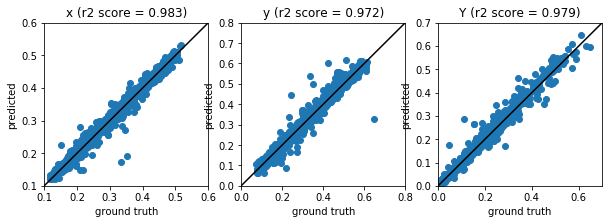

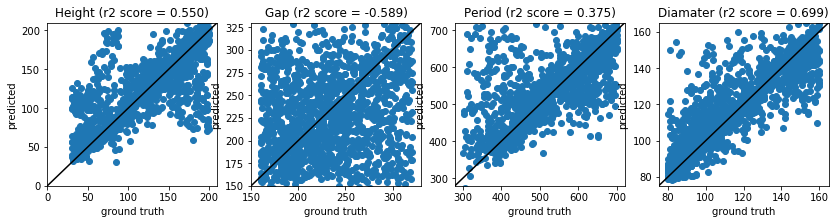

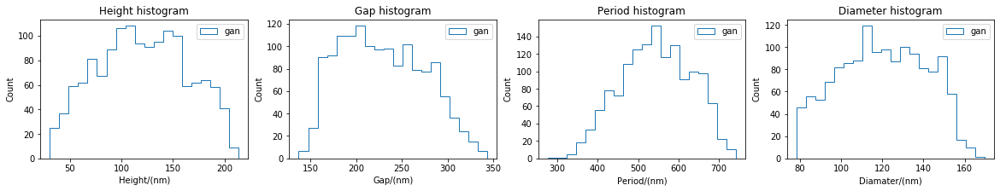

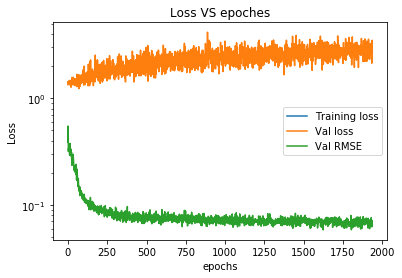

In [220]:
# Evaluate the performance of GAN
train_loader, val_loader, test_loader = get_dataloaders('gan')
configs = get_configs('gan')

gan_model = cGAN(configs['input_dim'], configs['output_dim'], configs['noise_dim']).to(DEVICE)
gan_path = './models/cgan/cgan_noise_2_g_0.001_d_0.001_STEP_True_trained.pth'
#gan_path = './models/w-cgan/w-cgan_noise_2_g_0.001_d_0.0001_STEP_False_trained.pth'
gan_model.load_state_dict(torch.load(gan_path)['model_state_dict'])

forward_model = MLP(4, 3).to(DEVICE)
forward_model.load_state_dict(torch.load('./models/forward_model_trained_evaluate_1.pth')['model_state_dict'])
cie_raw, param_raw, cie_pred, param_pred = evaluate_gan_minmax_inverse(gan_model, forward_model, test_loader.dataset, show=0)

plot_cie_raw_pred(cie_raw, cie_pred)
plot_struc_raw_pred(param_raw, param_pred)
plt_hist_struc(param_pred, 'gan')

train_loader, val_loader, test_loader = get_dataloaders('forward_model')

# plot the training and val loss VS epoches.
epochs = torch.load(gan_path)['epoch']
gan_loss_all = torch.load(gan_path)['loss_all']
plt.figure()
plt.plot(range(epochs),gan_loss_all[0,:epochs],label='Training loss')  
plt.plot(range(epochs),gan_loss_all[1,:epochs],label='Val loss')  
plt.plot(range(epochs),gan_loss_all[2,:epochs],label='Val RMSE')                      
plt.xlabel('epochs')
plt.ylabel('Loss')
plt.yscale('log')
plt.title('Loss VS epoches')
plt.legend()

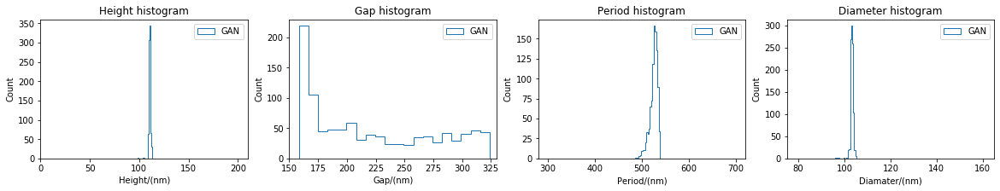

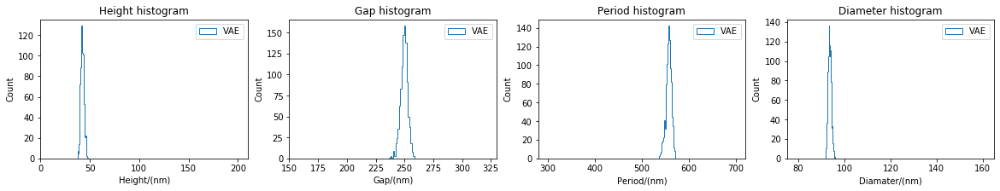

In [205]:
def plt_hist_struc1(param, labels):
    xlim = [[0, 210], [150, 330], [280, 720], [75, 165]]
    plt.figure(figsize = [20, 3])
    plt.subplot(1, 4,1)
    plt.hist(param[:,0], bins=20, histtype='step', label=labels)
    plt.title('Height histogram')
    plt.xlabel('Height/(nm)')
    plt.ylabel('Count')
    plt.xlim(xlim[0])
    plt.legend()
    
    plt.subplot(1, 4,2)
    plt.hist(param[:,1], bins=20, histtype='step', label=labels)
    plt.title('Gap histogram')
    plt.xlabel('Gap/(nm)')
    plt.xlim(xlim[1])
    
    plt.ylabel('Count')
    plt.legend()
    
    plt.subplot(1, 4, 3)
    plt.hist(param[:,2], bins=20, histtype='step', label=labels)
    plt.title('Period histogram')
    plt.xlabel('Period/(nm)')
    plt.ylabel('Count')
    plt.xlim(xlim[2])
    plt.legend()

    plt.subplot(1, 4, 4)
    plt.hist(param[:,3], bins=20, histtype='step', label=labels)
    plt.title('Diameter histogram')
    plt.xlabel('Diamater/(nm)')
    plt.ylabel('Count')
    plt.legend()
    plt.xlim(xlim[3])
    plt.show()


train_loader, val_loader, test_loader_gan = get_dataloaders('gan')
train_loader, val_loader, test_loader_vae = get_dataloaders('vae_hybrid')

forward_model = MLP(4, 3).to(DEVICE)
configs = get_configs('vae_hybrid')
vae_model = cVAE_GSNN1(configs['input_dim'], configs['latent_dim']).to(DEVICE)
model = cVAE_hybrid(forward_model, vae_model)
model.load_state_dict(torch.load('./models/vae_hybrid_GSNN1_1_trained.pth')['model_state_dict'])
forward_model.load_state_dict(torch.load('./models/forward_model_trained_evaluate_1.pth')['model_state_dict'])



M = 1000
T = 1000
param_gan = np.zeros([M, 4])
param_vae = np.zeros([M, 4])
for i in range(M):
    cie_raw, param_raw, cie_pred, param_pred = evaluate_gan_minmax_inverse(gan_model, forward_model, test_loader_gan.dataset, show=0)
    param_gan[i, :] = param_pred[T, :]
    cie_raw, param_raw, cie_pred, param_pred = evaluate_vae_GSNN_minmax_inverse(model.vae_model, forward_model, test_loader_vae.dataset, show=0)
    param_vae[i, :] = param_pred[T, :]

plt_hist_struc1(param_gan, 'GAN')
plt_hist_struc1(param_vae, 'VAE')

In [71]:
print(param_raw[T,:])
print(cie_raw[T,:])
print(T)

[102.00000077 278.99999619 471.00000381 107.00000048]
[0.15853915 0.13795607 0.05584854]
300


In [81]:
print(param_raw[T,:])
print(cie_raw[T,:])
print(T)

[ 45.00000037 281.99999809 633.99999142 100.        ]
[0.15502242 0.13058134 0.03830597]
1000


In [211]:
print(gan_loss_all[2,epochs])
print(torch.load(gan_path)['configs'])

0.057786608580807745
Namespace(batch_size=128, beta_1=0.5, beta_2=0.999, d_lr=0.001, epoch_lr_de=4000, epochs=20000, g_lr=0.001, if_lr_de=True, input_dim=3, lr_de=0.5, model='cGAN', noise_dim=2, output_dim=4, prior=1, weight_decay=1e-05)
